<a href="https://colab.research.google.com/github/jlopez-i/DataScience/blob/main/Modulo_El_Trabajo_de_la_Ciencia_de_Datos.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Caso Repaso - Modulo El Trabajo de la Ciencia de Datos


## 1. Introducción

En los anteriores casos, hemos utilizado herramientas comerciales como Qlik Sense o BigML para realizar las tareas de la Ciencia de Datos.

Ahora vamos a presentar una de las herramientas más populares que se utilizan: los ***notebooks***: Un notebook es un entorno de computación interactivo basado en una interfaz web que permite combinar la edición de textos (se puede incluir imagénes, textos formateados, enlaces, etc.) con código fuente, gráficos. Un notebook se compone de una lista ordenada de celdas, que pueden ser de dos tipos:

1.   Texto con formato *[Markdown](https://es.wikipedia.org/wiki/Markdown)*
2.   Código fuente de un lenguaje de programación.

Todas las celdas son editables y las celdas de código además se pueden ejecutar, mostrando los resultados de la ejecución en un espacio adjacente a la celda. Para ejecutar una celda de código hay que seleccionarlo primero y pulsar el icono que aparece en la parte superior del margen izquierdo.

Como lenguaje de programación hemos elegido *Python*, por ser uno de los más populares.


### 1.1 Configuración del entorno

Ejecutar la siguiente celda para configurar el entorno.

In [ ]:
import pandas as pd                # Librería de manejo de datos tabulares
import numpy as np                 # Librería de manejo de vectores y matrices

import seaborn as sns              # Librería de visualización
import matplotlib.pyplot as plt

from google.colab import files
from google.colab import data_table
from sklearn.preprocessing import MinMaxScaler, StandardScaler
from pathlib import Path
from sklearn import linear_model
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.model_selection import train_test_split

pd.options.display.float_format = "{:.2f}".format
sns.set(color_codes=True)
sns.set_theme(style="white")
rng = np.random.default_rng(47)
print(f"Inicio OK: {int(rng.random()*1e4)}")

Inicio OK: 7418


### 1.2 Metodología

Siguiendo lo expuesto en el contenido del módulo, vamos a utilizar la metodología CRISP-DM para abordar este proyecto. Recordar que consta de las siguientes fases:

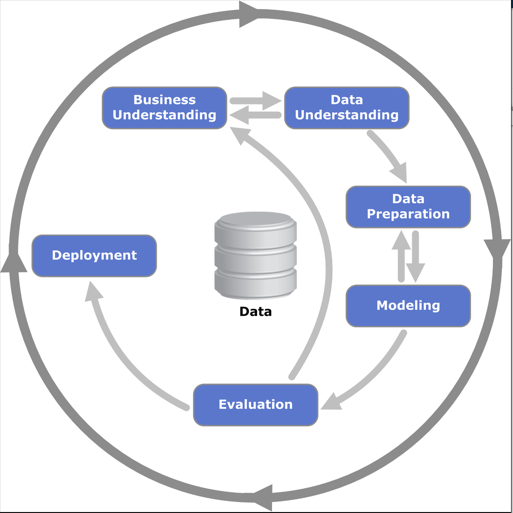



## 2. Entendimiento del negocio

Como se expone en el enunciado, lo que se pretende es estimar la **facturación de cada cliente**. Concretamente, lo que vamos a ilustrar es como estimar la variable TotalFacturado del *dataset* "VALTEL_Clientes.csv".

## 3. Entendimiento de los datos

Para comenzar el entendimiento de los datos, debemos subir el fichero "VALTEL_Clientes.csv" (al darle al botón de ejecutar, aparecerá en la parte inferior de la celda un botón "Elegir archivos")

In [ ]:
uploaded = files.upload()

for fn in uploaded.keys():
  print('Se ha subido el fichero "{name}" con longitud {length} bytes'.format(
      name=fn, length=len(uploaded[fn])))

print()
print(f"Descarga OK: {int(rng.random()*1e4)}")

Saving VALTEL_Clientes.csv to VALTEL_Clientes (5).csv
Se ha subido el fichero "VALTEL_Clientes.csv" con longitud 1014397 bytes

Descarga OK: 7536


### 3.1 Descripción general de los datos

In [ ]:
print(f"Tamaño del fichero: {Path('VALTEL_Clientes.csv').stat().st_size} bytes")
print()
print("Número total de líneas:")
!wc -l VALTEL_Clientes.csv
print()
print("Primeras 10 líneas:")
!head -n 10 VALTEL_Clientes.csv
print("...")
print("Últimas 10 líneas")
!tail -n 10 VALTEL_Clientes.csv

Tamaño del fichero: 1014397 bytes

Número total de líneas:
7044 VALTEL_Clientes.csv

Primeras 10 líneas:
IdCliente;Sexo;Jubilado;Pareja;Dependientes;Antig�edad;Tel�fono;MultiplesL�neas;Internet;SeguridadOnline;BackupOnline;SeguroDispositivo;SoporteT�cnico;Televisi�n;Cine;Contrato;FacturaElectr�nica;M�todoPago;CargoMensual;TotalFacturado;Baja
7590-VHVEG;Mujer;0;S�;No;1;No;Sin servicio de telefon�a;DSL;No;S�;No;No;No;No;Mes a mes;S�;Cheque electr�nico;29.85;29.85;No
5575-GNVDE;Hombre;0;No;No;34;S�;No;DSL;S�;No;S�;No;No;No;Un a�o;No;Cheque por correo;56.95;1889.5;No
3668-QPYBK;Hombre;0;No;No;2;S�;No;DSL;S�;S�;No;No;No;No;Mes a mes;S�;Cheque por correo;53.85;108.15;S�
7795-CFOCW;Hombre;0;No;No;45;No;Sin servicio de telefon�a;DSL;S�;No;S�;S�;No;No;Un a�o;No;Transferencia bancaria (autom�tica);42.3;1840.75;No
9237-HQITU;Mujer;0;No;No;2;S�;No;Fibra �ptica;No;No;No;No;No;No;Mes a mes;S�;Cheque electr�nico;70.7;151.65;S�
9305-CDSKC;Mujer;0;No;No;8;S�;S�;Fibra �ptica;No;No;S�;No;S�;S�;Mes a mes;

In [ ]:
df = pd.read_csv("VALTEL_Clientes.csv", sep=';', encoding='ISO-8859-1') # como la codificación del fichero es ANSI, hay que ponerla explícitamente, igual que el separador ";"
data_table.DataTable.max_columns = 30 # Por defecto, el límite de columnas es 20
data_table.DataTable(df, include_index=False, num_rows_per_page=10)

,IdCliente,Sexo,Jubilado,Pareja,Dependientes,Antigüedad,Teléfono,MultiplesLíneas,Internet,SeguridadOnline,...,SeguroDispositivo,SoporteTécnico,Televisión,Cine,Contrato,FacturaElectrónica,MétodoPago,CargoMensual,TotalFacturado,Baja
0,7590-VHVEG,Mujer,0,Sí,No,1,No,Sin servicio de telefonía,DSL,No,...,No,No,No,No,Mes a mes,Sí,Cheque electrónico,29.85,29.85,No
1,5575-GNVDE,Hombre,0,No,No,34,Sí,No,DSL,Sí,...,Sí,No,No,No,Un año,No,Cheque por correo,56.95,1889.5,No
2,3668-QPYBK,Hombre,0,No,No,2,Sí,No,DSL,Sí,...,No,No,No,No,Mes a mes,Sí,Cheque por correo,53.85,108.15,Sí
3,7795-CFOCW,Hombre,0,No,No,45,No,Sin servicio de telefonía,DSL,Sí,...,Sí,Sí,No,No,Un año,No,Transferencia bancaria (automática),42.30,1840.75,No
4,9237-HQITU,Mujer,0,No,No,2,Sí,No,Fibra óptica,No,...,No,No,No,No,Mes a mes,Sí,Cheque electrónico,70.70,151.65,Sí
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7038,6840-RESVB,Hombre,0,Sí,Sí,24,Sí,Sí,DSL,Sí,...,Sí,Sí,Sí,Sí,Un año,Sí,Cheque por correo,84.80,1990.5,No
7039,2234-XADUH,Mujer,0,Sí,Sí,72,Sí,Sí,Fibra óptica,No,...,Sí,No,Sí,Sí,Un año,Sí,Tarjeta crédito (automática),103.20,7362.9,No
7040,4801-JZAZL,Mujer,0,Sí,Sí,11,No,Sin servicio de telefonía,DSL,Sí,...,No,No,No,No,Mes a mes,Sí,Cheque electrónico,29.60,346.45,No
7041,8361-LTMKD,Hombre,1,Sí,No,4,Sí,Sí,Fibra óptica,No,...,No,No,No,No,Mes a mes,Sí,Cheque por correo,74.40,306.6,Sí


Veamos el tipo de datos de cada variable:

In [ ]:
print (df.dtypes)

IdCliente              object
Sexo                   object
Jubilado                int64
Pareja                 object
Dependientes           object
Antigüedad              int64
Teléfono               object
MultiplesLíneas        object
Internet               object
SeguridadOnline        object
BackupOnline           object
SeguroDispositivo      object
SoporteTécnico         object
Televisión             object
Cine                   object
Contrato               object
FacturaElectrónica     object
MétodoPago             object
CargoMensual          float64
TotalFacturado         object
Baja                   object
dtype: object


Donde *object* representa a un variable categórica (cadena), *int64* es un número entero y *float64* un número real.

De este primer vistazo, se puede observar que:
*  **TotalFacturado** nos lo interpreta como una variable categórica, cuando debería ser numérica contínua. Esto es debido a que existen valores con un espacio en blancoDebemos eliminarlos y forzar a que lo interprete adecuadamente.
*  **Jubilado** nos lo interpreta como un número al ser 0 o 1. Vamos a forzarlo a que sea una variable categórica.

In [ ]:
# Reemplazar blancos por 0 y forzar a conversión numérica.
df['TotalFacturado'] = df['TotalFacturado'].replace(' ', 0)
df["TotalFacturado"] = pd.to_numeric(df["TotalFacturado"])
print (df.dtypes)

IdCliente              object
Sexo                   object
Jubilado                int64
Pareja                 object
Dependientes           object
Antigüedad              int64
Teléfono               object
MultiplesLíneas        object
Internet               object
SeguridadOnline        object
BackupOnline           object
SeguroDispositivo      object
SoporteTécnico         object
Televisión             object
Cine                   object
Contrato               object
FacturaElectrónica     object
MétodoPago             object
CargoMensual          float64
TotalFacturado        float64
Baja                   object
dtype: object


### 3.2 Análisis Univariante

Para comenzar el análisis univariante, vamos a crear dos dataframe separados con las variables cualitativas y las cuantitativas, donde nos preparamos los estadísticos básicos de cada una. Esto nos facilitará el estudio por separado.

In [ ]:
def analyze_df(df):
  data_types = dict(df.dtypes)
  numeric_cols = []
  categoric_cols = []
  for c,t in data_types.items():
    if t == np.float64:
      numeric_cols.append([c, 'Cuantitativa continua', df[c].mean(), df[c].min(), df[c].max(), df[c].median()])
    elif t == np.int64 or pd.Int64Dtype.is_dtype(t):
      numeric_cols.append([c, 'Cuantitativa discreta', df[c].mean(), df[c].min(), df[c].max(), df[c].median()])
    else:
      categoric_cols.append([c, f'Cualitativa', df[c].nunique()])
  n = pd.DataFrame(numeric_cols, columns=['Nombre', 'Tipo de variable', 'Media', 'Mínimo', 'Máximo', 'Mediana'])
  c = pd.DataFrame(categoric_cols, columns=['Nombre', 'Tipo de variable', 'Número de clases'])
  return n, c

numeric_types, categoric_types = analyze_df(df)
print("Finalizado OK")


Finalizado OK


#### 3.2.1 Variables Cualitativas

Ejecutando la siguiente celda, permite observar las columnas con datos cualitativos junto con el número de clases de cada una de ellas.

In [ ]:
print(categoric_types.to_string(index=False))

            Nombre Tipo de variable  Número de clases
         IdCliente      Cualitativa              7043
              Sexo      Cualitativa                 2
            Pareja      Cualitativa                 2
      Dependientes      Cualitativa                 2
          Teléfono      Cualitativa                 2
   MultiplesLíneas      Cualitativa                 3
          Internet      Cualitativa                 3
   SeguridadOnline      Cualitativa                 3
      BackupOnline      Cualitativa                 3
 SeguroDispositivo      Cualitativa                 3
    SoporteTécnico      Cualitativa                 3
        Televisión      Cualitativa                 3
              Cine      Cualitativa                 3
          Contrato      Cualitativa                 3
FacturaElectrónica      Cualitativa                 2
        MétodoPago      Cualitativa                 4
              Baja      Cualitativa                 2


Para conocer los valores de cada variable hay que ejecutar el comando que aparece en la siguiente celda. Posteriormente, modifica el nombre de la variable cualitativa editando la celda, y ejecútala  de nuevopara explorar todas las clases de dichas variables.

In [ ]:
column = 'FacturaElectrónica'
print(df[column].unique())

['Sí' 'No']


Visualizamos las variables cualitativas para conocer su distribución de valores

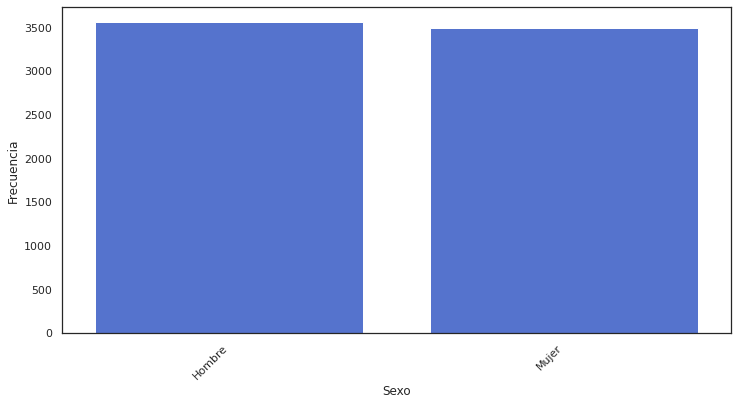

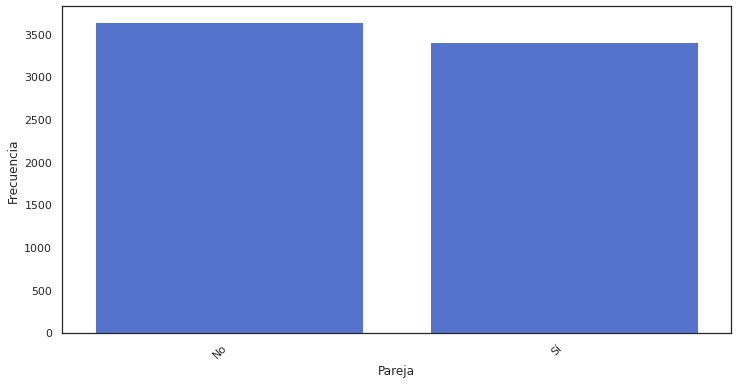

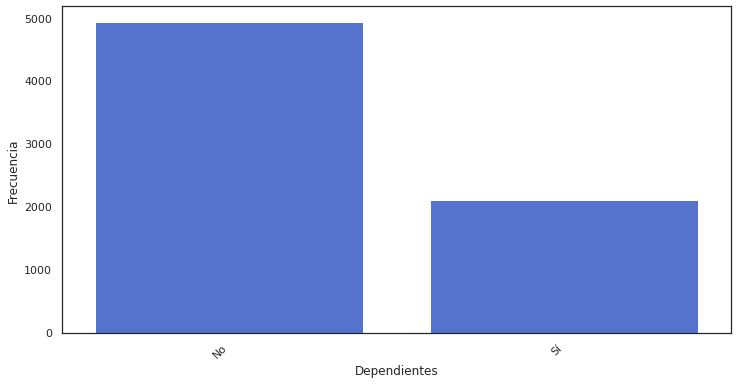

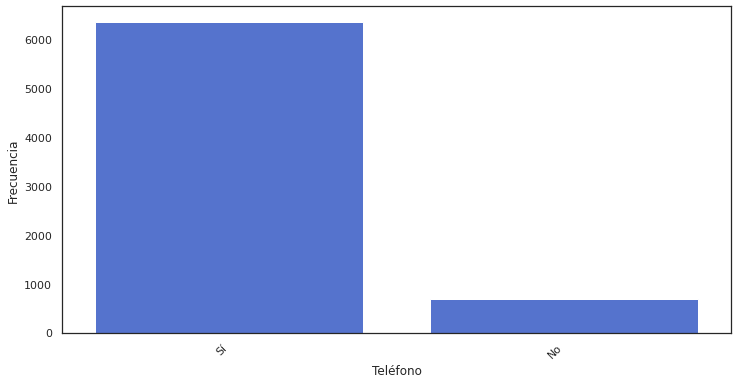

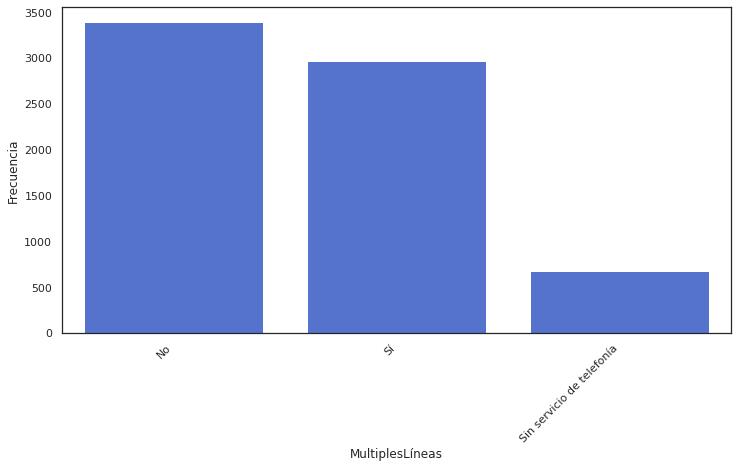

...

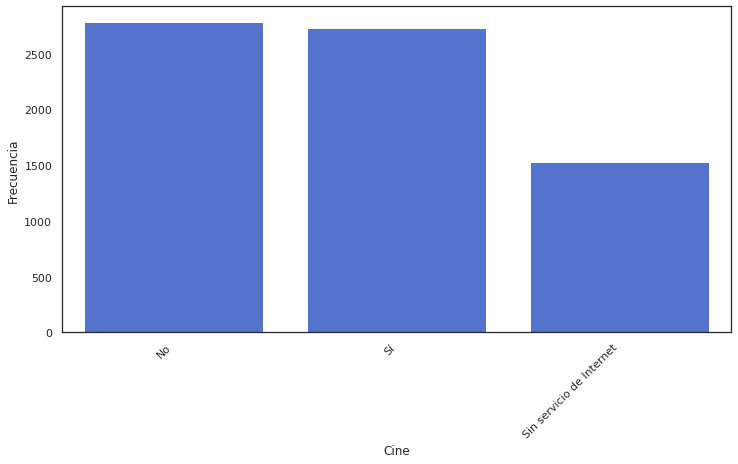

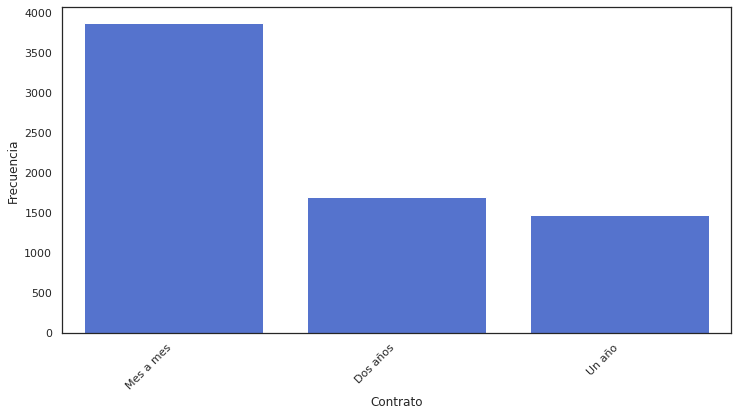

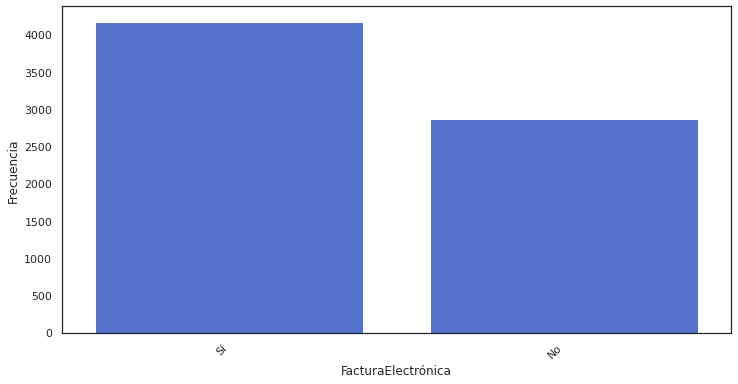

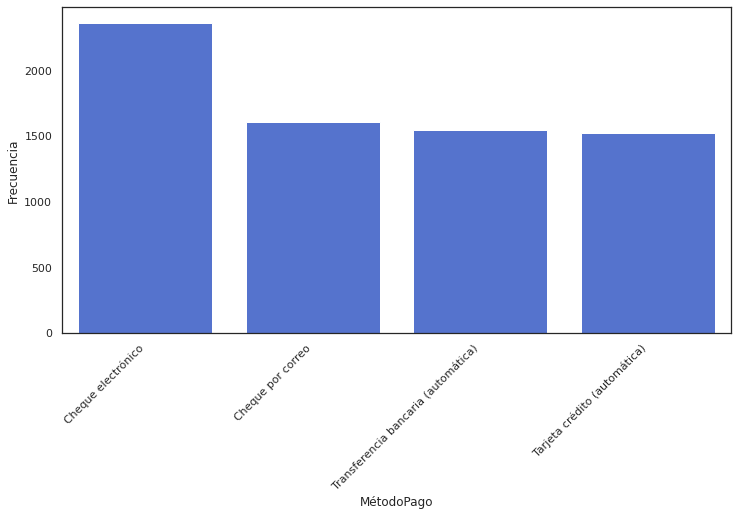

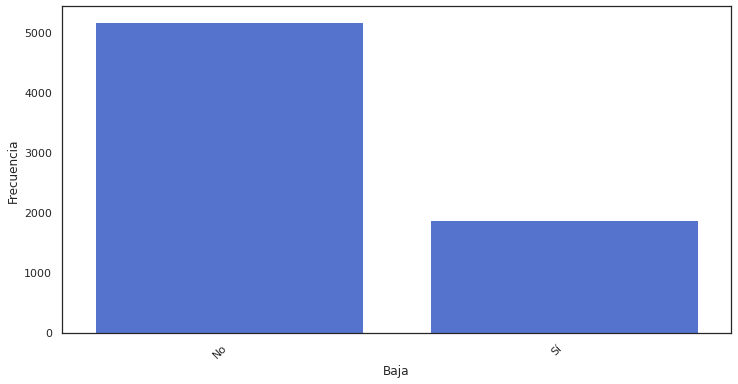

In [ ]:
for i in categoric_types.index:
    if categoric_types['Nombre'][i] != 'IdCliente':
      #print(categoric_types['Nombre'][i])
      column = categoric_types['Nombre'][i]
      fig, ax = plt.subplots(figsize=(12,6))
      chart = sns.countplot(data=df, x=column, color='royalblue', order = df[column].value_counts().index)
      chart.set_xticklabels(chart.get_xticklabels(), rotation=45, horizontalalignment='right');
      chart.set_ylabel('Frecuencia');
      plt.show();

#### 3.2.2 Variables Cuantitativas


Procedamos de manera análoga con las variables cuantitativas y vemos sus estadísticos básicos:

In [ ]:
print(numeric_types.to_string(index=False))

        Nombre      Tipo de variable   Media  Mínimo  Máximo  Mediana
      Jubilado Cuantitativa discreta    0.16    0.00    1.00     0.00
    Antigüedad Cuantitativa discreta   32.37    0.00   72.00    29.00
  CargoMensual Cuantitativa continua   64.76   18.25  118.75    70.35
TotalFacturado Cuantitativa continua 2279.73    0.00 8684.80  1394.55


Para conocer su distribución las visualizamos cada una con un histograma:

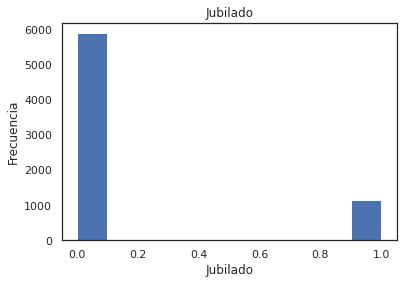

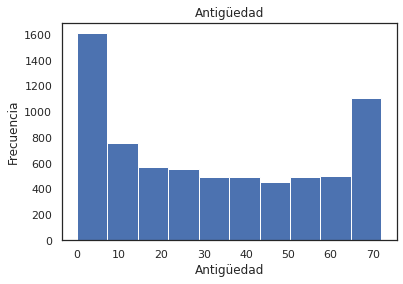

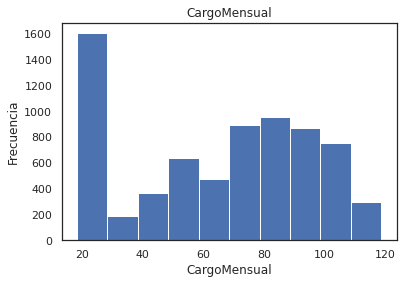

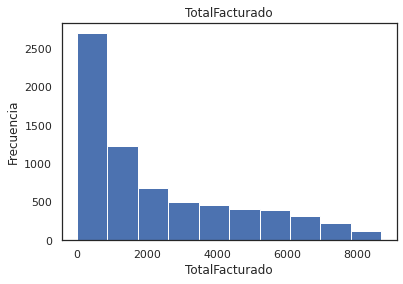

In [ ]:
for i in numeric_types.index:
    column = numeric_types['Nombre'][i]
    plt.hist(df[column])
    plt.xlabel(column)
    plt.ylabel('Frecuencia')
    plt.title(column)
    plt.show()

### 3.3. Análisis Bivariante

Vamos a realizar el análisis de cada variable frente a la variable objetivo que en este caso es el TotalFacturado.

#### 3.3.1 Variables Cualitativas vs Variable Objetivo


Para conocer el comportamiento de las variables cualitativas frente a la variable objetivo vamos a utilizar el BarPlot.

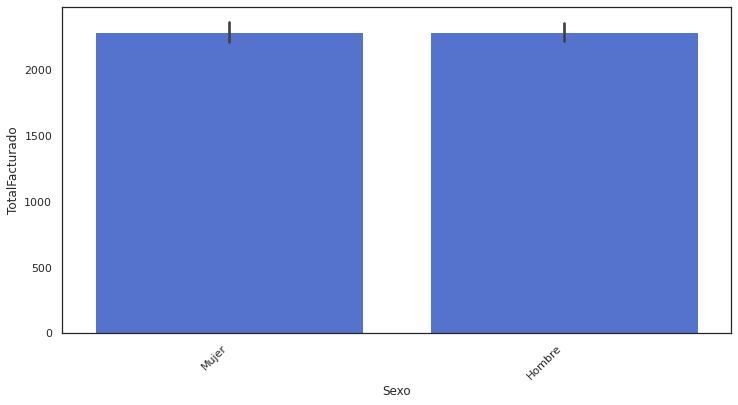

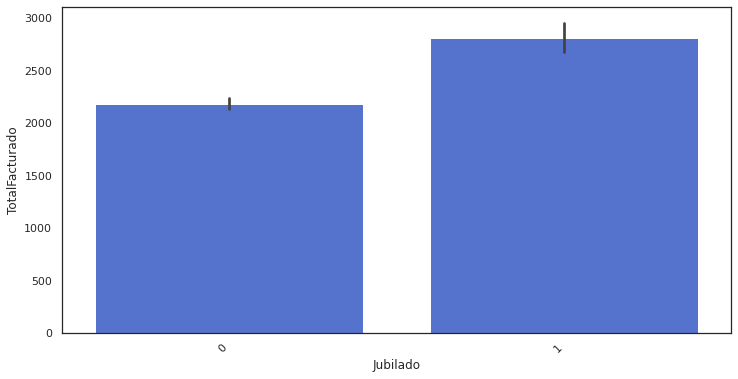

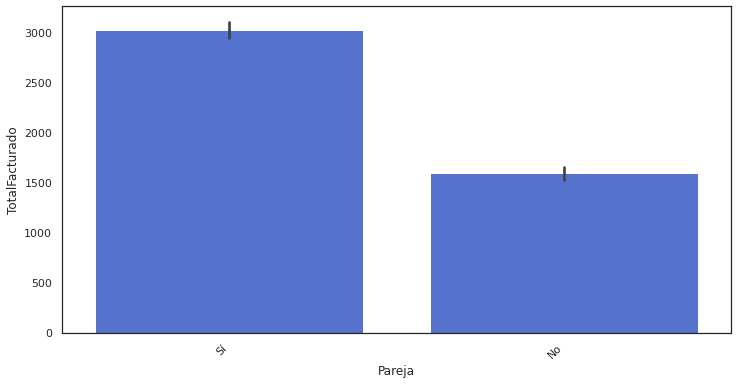

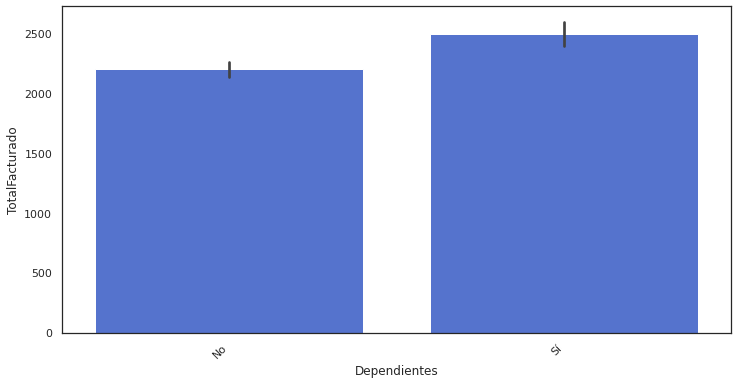

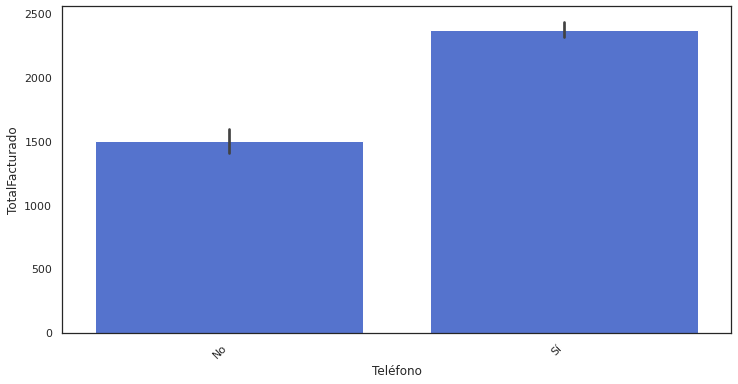

...

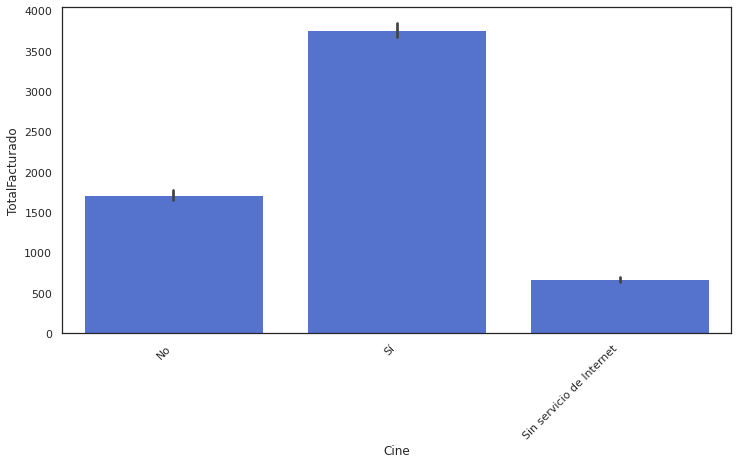

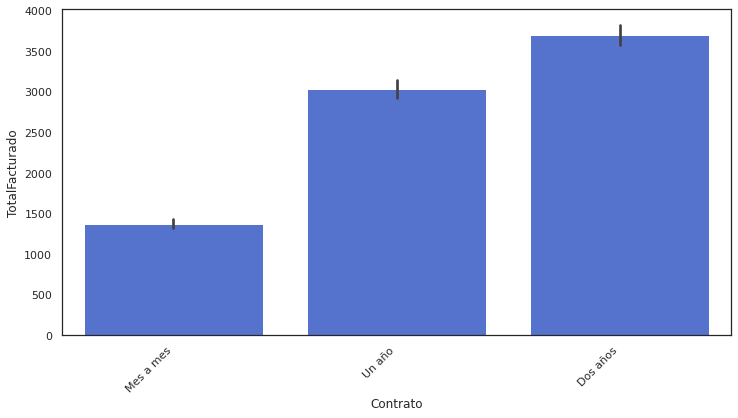

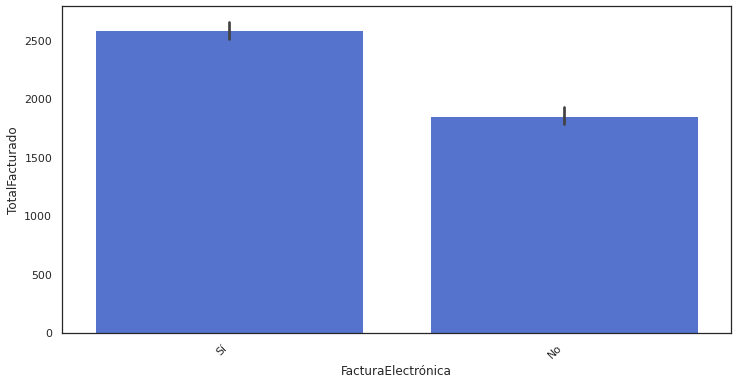

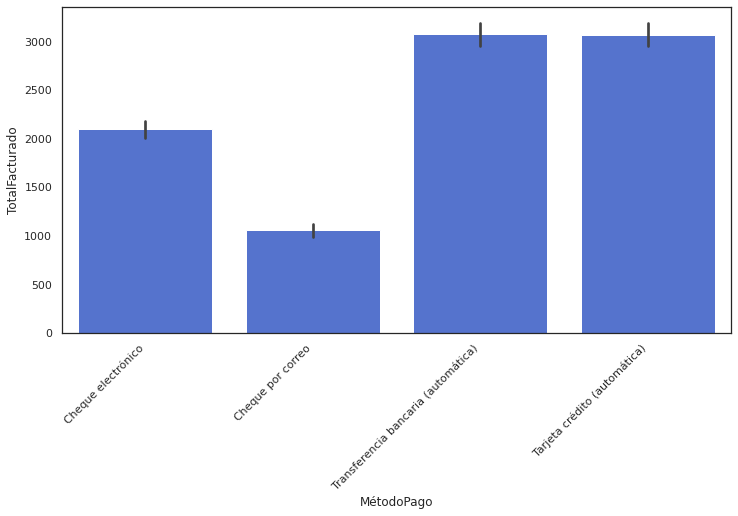

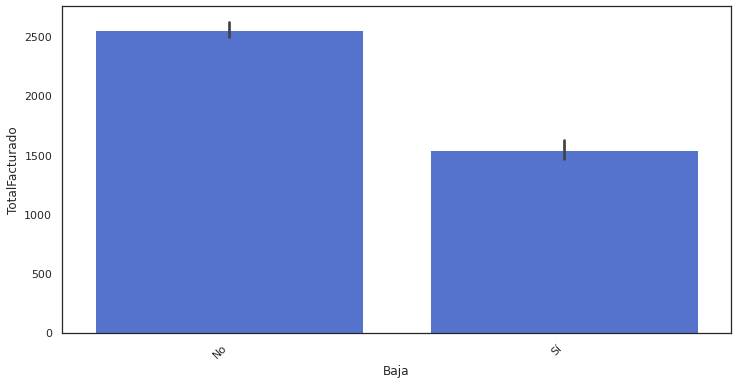

In [ ]:
for i in categoric_types.index:
    if categoric_types['Nombre'][i] != 'IdCliente':
      #print(categoric_types['Nombre'][i])
      x_axis = categoric_types['Nombre'][i]
      y_axis = 'TotalFacturado'
      fig, ax = plt.subplots(figsize=(12,6))
      chart = sns.barplot(data=df, x=x_axis, y=y_axis, color='royalblue')
      chart.set_xticklabels(chart.get_xticklabels(), rotation=45, horizontalalignment='right');
      plt.show();

Observe por cada variable, si hay una distribución uniforme de los valores o no, que nos indique posibles relaciones.

#### 3.3.2 Variables Cuantitativas vs Variable Objetivo

Para conocer el comportamiento de las variables cuantitativas frente a la variable objetivo vamos a utilizar el ScatterPlot.

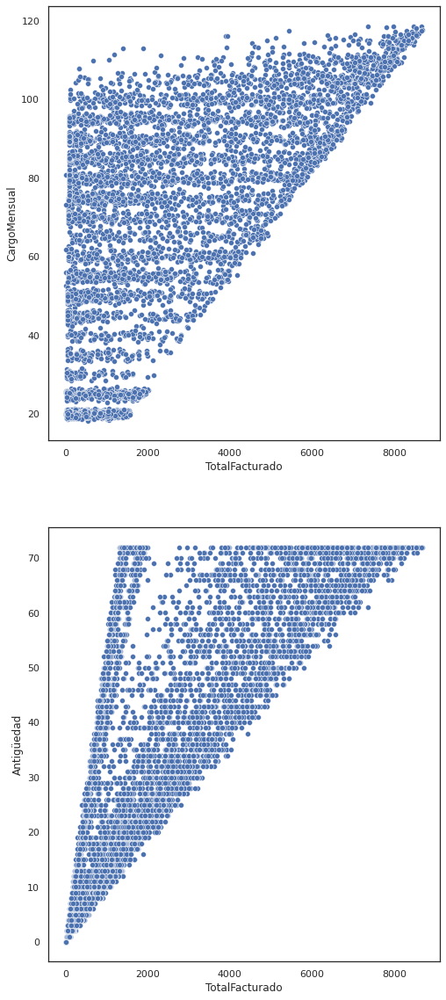

In [ ]:
fig, axs = plt.subplots(figsize=(8,20), nrows=2)
sns.scatterplot(data=df, x="TotalFacturado", y="CargoMensual", ax=axs[0])
sns.scatterplot(data=df, x="TotalFacturado", y="Antigüedad", ax=axs[1]);

Observe por cada variable, si hay una distribución uniforme de los valores o no, que nos indique posibles relaciones.

### 3.4. Análisis Multivariante

Tras el estudio frente a la variable objetivo, vamos a calcular la matriz de correlación para ver las dependencias entre variables cuantitativas.

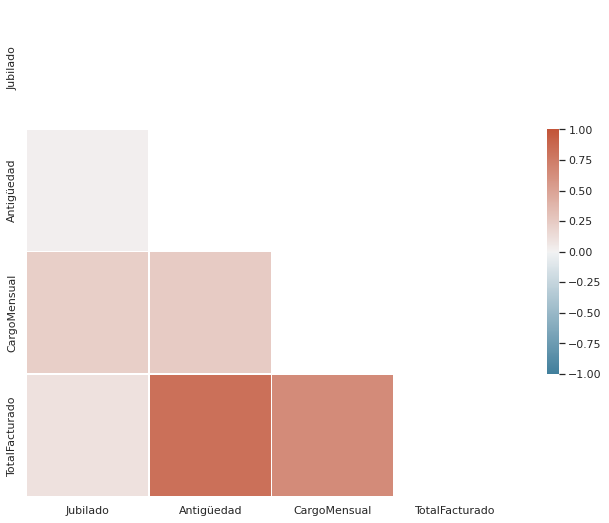

In [ ]:
corr = df.corr()
mask = np.triu(np.ones_like(corr, dtype=bool))
f, ax = plt.subplots(figsize=(11, 9))
cmap = sns.diverging_palette(230, 20, as_cmap=True)
sns.set_theme(style="white")
# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, mask=mask, cmap=cmap, vmax=1, vmin=-1, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5});

Para analizar de forma gráfica, la relación entre dos variables cualitativas, podemos utilizar un heatmap de la siguiente forma:

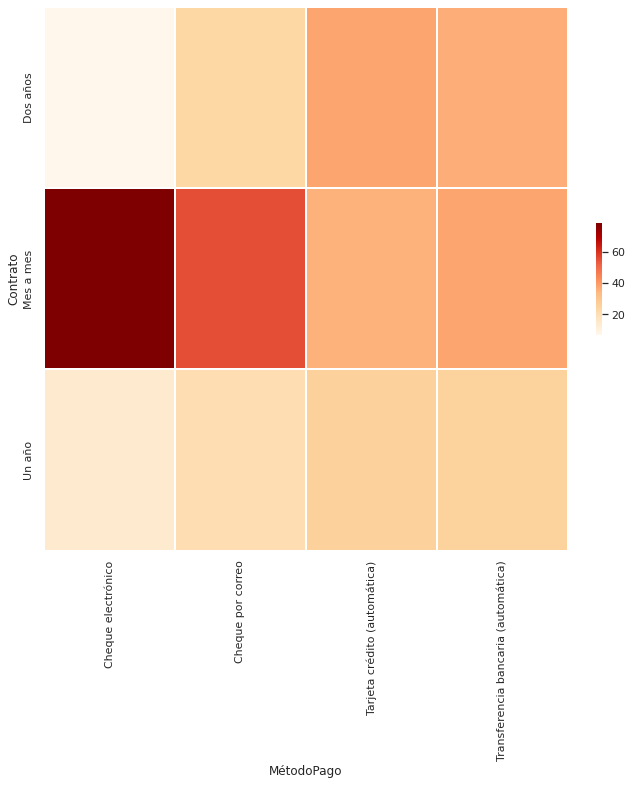

In [ ]:
by_maker = (df
            .groupby(['Contrato', 'MétodoPago'])
            .size()
            .groupby(level=1)
            .apply(lambda x: 100 * x / float(x.sum()))
            .unstack()
           )
by_maker.fillna(0, inplace=True)
plt.figure(figsize=(10,10))
g = sns.heatmap(
    by_maker,
    square=False, # make cells square
    cbar_kws={'fraction' : 0.01}, # shrink colour bar
    cmap='OrRd', # use orange/red colour map
    linewidth=1 # space between cells
)

### 3.5. Calidad del dato

#### 3.5.1 Detectar valores nulos

Aunque hemos detectado ya valores nulos en el campo TotalFacturado y lo hemos corregido para trabajar más cómodamente, vamos a ver aquí el procedimiento que seguiríamos para detectarlos:

In [ ]:
print("Número de filas válidas por columna:")
print(df.count().to_string())
print()

Número de filas válidas por columna:
IdCliente             7043
Sexo                  7043
Jubilado              7043
Pareja                7043
Dependientes          7043
Antigüedad            7043
Teléfono              7043
MultiplesLíneas       7043
Internet              7043
SeguridadOnline       7043
BackupOnline          7043
SeguroDispositivo     7043
SoporteTécnico        7043
Televisión            7043
Cine                  7043
Contrato              7043
FacturaElectrónica    7043
MétodoPago            7043
CargoMensual          7043
TotalFacturado        7043
Baja                  7043



Si el valor que obtenemos es menor al número total de filas, es que existen nulos y deberíamos corregirlos en la fase de preparación de los datos.

**NOTA**: En la práctica, la fase de calidad y de preparación de datos se suele hacer o bien antes o durante el EDA, en el sentido de que es más cómodo ir corrigiendo los errores conforme nos los vamos encontrando.

#### 3.5.2 Detectar valores atípicos

Analizamos los valores atípicos de las variables cuantitativas para descartarlos posteriormente.

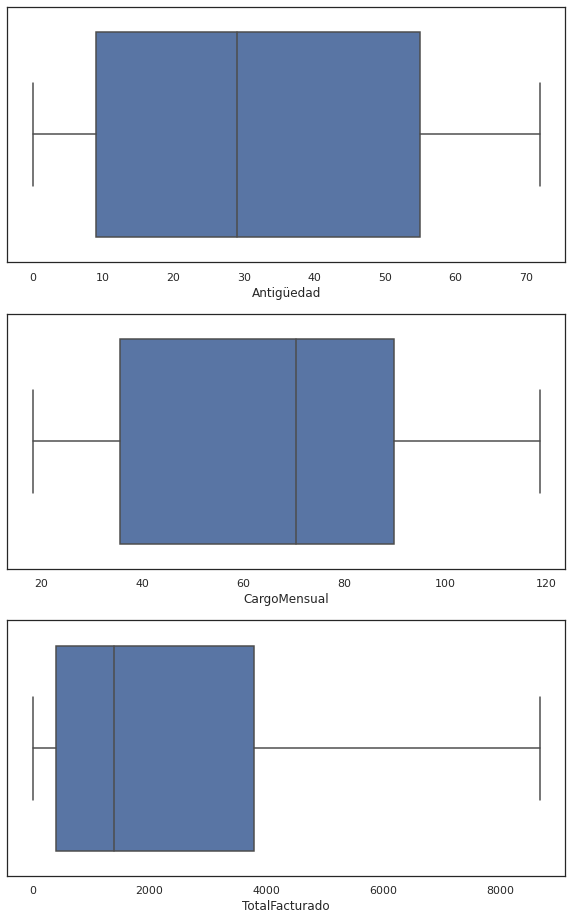

In [ ]:
fig, axs = plt.subplots(figsize=(10,16),nrows=3)
sns.boxplot(x=df['Antigüedad'], ax=axs[0])
sns.boxplot(x=df['CargoMensual'], ax=axs[1])
sns.boxplot(x=df['TotalFacturado'], ax=axs[2]);

## 4. Preparación de los datos

### 4.1. Seleccionar los datos

Seleccionamos las variables que son de nuestro interés. En este caso vamos a descartar el campo IdCliente

In [ ]:
df = df.drop(['IdCliente'], axis=1, errors='ignore')
data_table.DataTable(df, include_index=False, num_rows_per_page=5)

,Sexo,Jubilado,Pareja,Dependientes,Antigüedad,Teléfono,MultiplesLíneas,Internet,SeguridadOnline,BackupOnline,SeguroDispositivo,SoporteTécnico,Televisión,Cine,Contrato,FacturaElectrónica,MétodoPago,CargoMensual,TotalFacturado,Baja
0,Mujer,0,Sí,No,1,No,Sin servicio de telefonía,DSL,No,Sí,No,No,No,No,Mes a mes,Sí,Cheque electrónico,29.85,29.85,No
1,Hombre,0,No,No,34,Sí,No,DSL,Sí,No,Sí,No,No,No,Un año,No,Cheque por correo,56.95,1889.50,No
2,Hombre,0,No,No,2,Sí,No,DSL,Sí,Sí,No,No,No,No,Mes a mes,Sí,Cheque por correo,53.85,108.15,Sí
3,Hombre,0,No,No,45,No,Sin servicio de telefonía,DSL,Sí,No,Sí,Sí,No,No,Un año,No,Transferencia bancaria (automática),42.30,1840.75,No
4,Mujer,0,No,No,2,Sí,No,Fibra óptica,No,No,No,No,No,No,Mes a mes,Sí,Cheque electrónico,70.70,151.65,Sí
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7038,Hombre,0,Sí,Sí,24,Sí,Sí,DSL,Sí,No,Sí,Sí,Sí,Sí,Un año,Sí,Cheque por correo,84.80,1990.50,No
7039,Mujer,0,Sí,Sí,72,Sí,Sí,Fibra óptica,No,Sí,Sí,No,Sí,Sí,Un año,Sí,Tarjeta crédito (automática),103.20,7362.90,No
7040,Mujer,0,Sí,Sí,11,No,Sin servicio de telefonía,DSL,Sí,No,No,No,No,No,Mes a mes,Sí,Cheque electrónico,29.60,346.45,No
7041,Hombre,1,Sí,No,4,Sí,Sí,Fibra óptica,No,No,No,No,No,No,Mes a mes,Sí,Cheque por correo,74.40,306.60,Sí


### 4.2 Limpieza de datos

#### 4.2.1 Eliminar nulos

Para eliminar los nulos utilizaremos el siguiente código:

In [ ]:
print("Eliminando datos nulos:")
print()
df = df.dropna()
#Aprovechamos para formatear los tipos de datos correctamente
df = df.astype({"TotalFacturado": float})
df = df.astype({"Antigüedad": int})
df = df.astype({"Jubilado": object})
print("Número de filas válidas por columna:")
print(df.count().to_string())

Eliminando datos nulos:

Número de filas válidas por columna:
Sexo                  7043
Jubilado              7043
Pareja                7043
Dependientes          7043
Antigüedad            7043
Teléfono              7043
MultiplesLíneas       7043
Internet              7043
SeguridadOnline       7043
BackupOnline          7043
SeguroDispositivo     7043
SoporteTécnico        7043
Televisión            7043
Cine                  7043
Contrato              7043
FacturaElectrónica    7043
MétodoPago            7043
CargoMensual          7043
TotalFacturado        7043
Baja                  7043


#### 4.2.2 Eliminar registros duplicados

Aunque en este *dataset* no existen filas duplicadas, deberíamos tenerlo en cuenta:

In [ ]:
print(f"Número de filas: {df.shape[0]}")
print(f"Número de columnas: {df.shape[1]}")
print()
print("Eliminando filas con valores duplicados...")
df = df.drop_duplicates()
print()
print(f"Número de filas: {df.shape[0]}")
print(f"Número de columnas: {df.shape[1]}")

Número de filas: 7043
Número de columnas: 20

Eliminando filas con valores duplicados...

Número de filas: 7021
Número de columnas: 20


#### 4.2.3 Eliminar valores atípicos

Con el siguiente código eliminamos los valores atípicos indicando los nombres de las columnas en el vector *columns_with_outliers*

Número de filas (con valores atípicos): 7021
Eliminando valores atípicos...
Número de filas (sin valores atípicos): 7021

Datos Cuantitativos:
        Nombre      Tipo de variable   Media  Mínimo  Máximo  Mediana
    Antigüedad Cuantitativa discreta   32.47    0.00   72.00    29.00
  CargoMensual Cuantitativa continua   64.85   18.25  118.75    70.40
TotalFacturado Cuantitativa continua 2286.77    0.00 8684.80  1400.55



/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:7: FutureWarning: Automatic reindexing on DataFrame vs Series comparisons is deprecated and will raise ValueError in a future version.  Do `left, right = left.align(right, axis=1, copy=False)` before e.g. `left == right`
  import sys


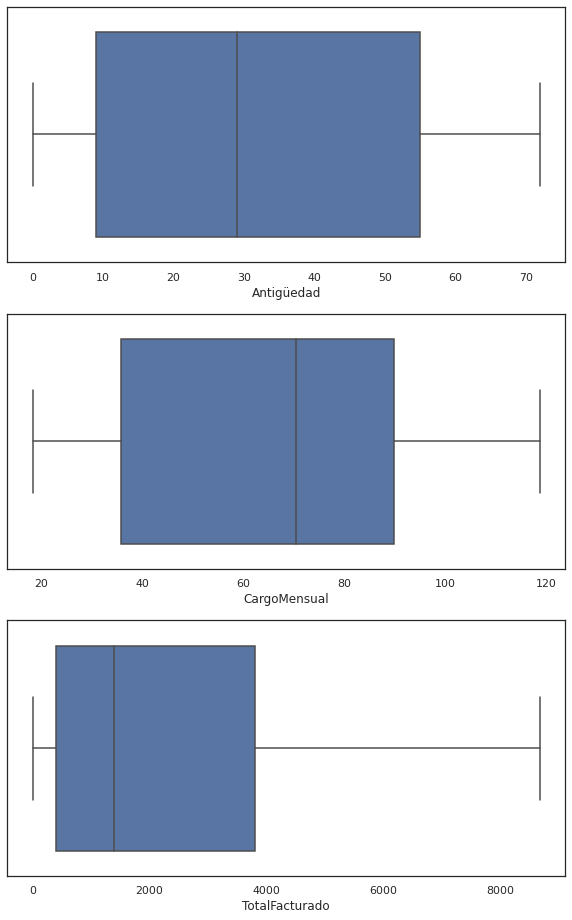

In [ ]:
columns_with_outliers = ['Antigüedad','CargoMensual','TotalFacturado']
print(f"Número de filas (con valores atípicos): {df.shape[0]}")
print("Eliminando valores atípicos...")
Q1 = df[columns_with_outliers].quantile(0.25)
Q3 = df[['Antigüedad','CargoMensual','TotalFacturado']].quantile(0.75)
IQR = Q3 - Q1
df2 = df[~((df < (Q1 - 1.5 * IQR)) | (df > (Q3 + 1.5 * IQR))).any(axis=1)]
print(f"Número de filas (sin valores atípicos): {df2.shape[0]}")
numeric_types, categoric_types = analyze_df(df2)
print()
print("Datos Cuantitativos:")
print(numeric_types.to_string(index=False))
print()
fig, axs = plt.subplots(figsize=(10,16), nrows=3)
sns.boxplot(x=df2['Antigüedad'], ax=axs[0])
sns.boxplot(x=df2['CargoMensual'], ax=axs[1])
sns.boxplot(x=df2['TotalFacturado'], ax=axs[2]);

### 4.3 Construir

Vamos a incluir un ejemplo de **normalización** de la variable Antigüedad:

In [ ]:
scaler = MinMaxScaler()
df2[['Antigüedad']] = scaler.fit_transform(df2[['Antigüedad']])
data_table.DataTable(df2, include_index=False, num_rows_per_page=5)

,Sexo,Jubilado,Pareja,Dependientes,Antigüedad,Teléfono,MultiplesLíneas,Internet,SeguridadOnline,BackupOnline,SeguroDispositivo,SoporteTécnico,Televisión,Cine,Contrato,FacturaElectrónica,MétodoPago,CargoMensual,TotalFacturado,Baja
0,Mujer,0,Sí,No,0.01,No,Sin servicio de telefonía,DSL,No,Sí,No,No,No,No,Mes a mes,Sí,Cheque electrónico,29.85,29.85,No
1,Hombre,0,No,No,0.47,Sí,No,DSL,Sí,No,Sí,No,No,No,Un año,No,Cheque por correo,56.95,1889.50,No
2,Hombre,0,No,No,0.03,Sí,No,DSL,Sí,Sí,No,No,No,No,Mes a mes,Sí,Cheque por correo,53.85,108.15,Sí
3,Hombre,0,No,No,0.62,No,Sin servicio de telefonía,DSL,Sí,No,Sí,Sí,No,No,Un año,No,Transferencia bancaria (automática),42.30,1840.75,No
4,Mujer,0,No,No,0.03,Sí,No,Fibra óptica,No,No,No,No,No,No,Mes a mes,Sí,Cheque electrónico,70.70,151.65,Sí
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7038,Hombre,0,Sí,Sí,0.33,Sí,Sí,DSL,Sí,No,Sí,Sí,Sí,Sí,Un año,Sí,Cheque por correo,84.80,1990.50,No
7039,Mujer,0,Sí,Sí,1.00,Sí,Sí,Fibra óptica,No,Sí,Sí,No,Sí,Sí,Un año,Sí,Tarjeta crédito (automática),103.20,7362.90,No
7040,Mujer,0,Sí,Sí,0.15,No,Sin servicio de telefonía,DSL,Sí,No,No,No,No,No,Mes a mes,Sí,Cheque electrónico,29.60,346.45,No
7041,Hombre,1,Sí,No,0.06,Sí,Sí,Fibra óptica,No,No,No,No,No,No,Mes a mes,Sí,Cheque por correo,74.40,306.60,Sí


### 4.4. Formatear

Como la mayor parte de modelos de machine learning en scikit-learn necesitan variables numéricas para funcionar, vamos a utilizar una técnica de codificación que nos permite transformar variabels categóricas en numéricas.

In [ ]:
from sklearn.preprocessing import OneHotEncoder

for i in categoric_types.index:
  column = categoric_types['Nombre'][i]
  print(column)
  ohe = OneHotEncoder()
  transformed = ohe.fit_transform(df2[[column]])
  df2[column] = transformed.toarray();

data_table.DataTable(df2, include_index=False, num_rows_per_page=5)



Sexo
Jubilado
Pareja
Dependientes
Teléfono
MultiplesLíneas
Internet
SeguridadOnline
BackupOnline
SeguroDispositivo
SoporteTécnico
Televisión
Cine
Contrato
FacturaElectrónica
MétodoPago
Baja


,Sexo,Jubilado,Pareja,Dependientes,Antigüedad,Teléfono,MultiplesLíneas,Internet,SeguridadOnline,BackupOnline,SeguroDispositivo,SoporteTécnico,Televisión,Cine,Contrato,FacturaElectrónica,MétodoPago,CargoMensual,TotalFacturado,Baja
0,1.00,0.00,1.00,0.00,0.01,0.00,1.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,1.00,1.00,0.00,29.85,29.85,0.00
1,0.00,0.00,0.00,0.00,0.47,1.00,0.00,0.00,1.00,0.00,1.00,0.00,0.00,0.00,1.00,0.00,1.00,56.95,1889.50,0.00
2,0.00,0.00,0.00,0.00,0.03,1.00,0.00,0.00,1.00,1.00,0.00,0.00,0.00,0.00,1.00,1.00,1.00,53.85,108.15,1.00
3,0.00,0.00,0.00,0.00,0.62,0.00,1.00,0.00,1.00,0.00,1.00,1.00,0.00,0.00,1.00,0.00,1.00,42.30,1840.75,0.00
4,1.00,0.00,0.00,0.00,0.03,1.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,1.00,0.00,70.70,151.65,1.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7038,0.00,0.00,1.00,1.00,0.33,1.00,1.00,0.00,1.00,0.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,84.80,1990.50,0.00
7039,1.00,0.00,1.00,1.00,1.00,1.00,1.00,1.00,0.00,1.00,1.00,0.00,1.00,1.00,1.00,1.00,1.00,103.20,7362.90,0.00
7040,1.00,0.00,1.00,1.00,0.15,0.00,1.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,1.00,1.00,0.00,29.60,346.45,0.00
7041,0.00,1.00,1.00,0.00,0.06,1.00,1.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,1.00,1.00,74.40,306.60,1.00


Probemos ahora a detectar posibles correlaciones:

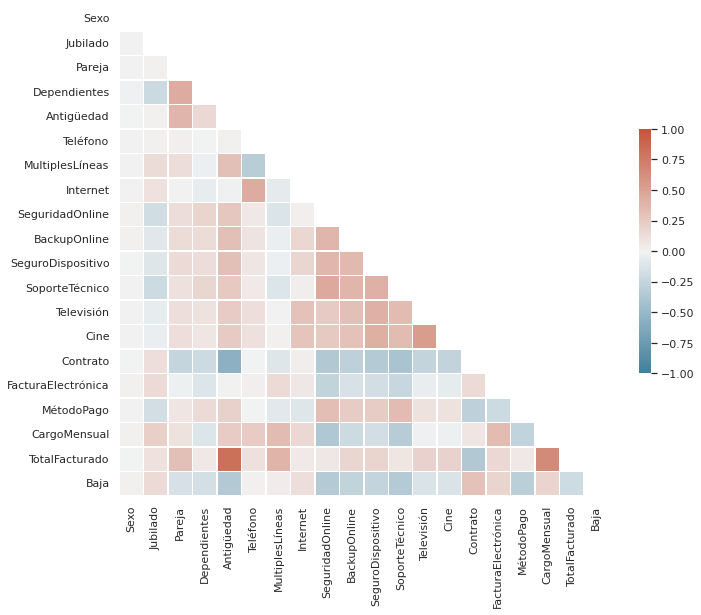

In [ ]:
corr = df2.corr()
mask = np.triu(np.ones_like(corr, dtype=bool))
f, ax = plt.subplots(figsize=(11, 9))
cmap = sns.diverging_palette(230, 20, as_cmap=True)
sns.set_theme(style="white")
# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, mask=mask, cmap=cmap, vmax=1, vmin=-1, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5});

Como se puede observar las dos variables cuantitativas, Antigüedad y CargoMensual son las que más correlacionadas se encuentran con nuestra variable objetivo TotalFacturado.

## 5. Desarrollo y Evaluación del modelo

Como queremos estimar una variable cuantitativa, es un problema de regresión y siguiendo la guía de scikit-learn:
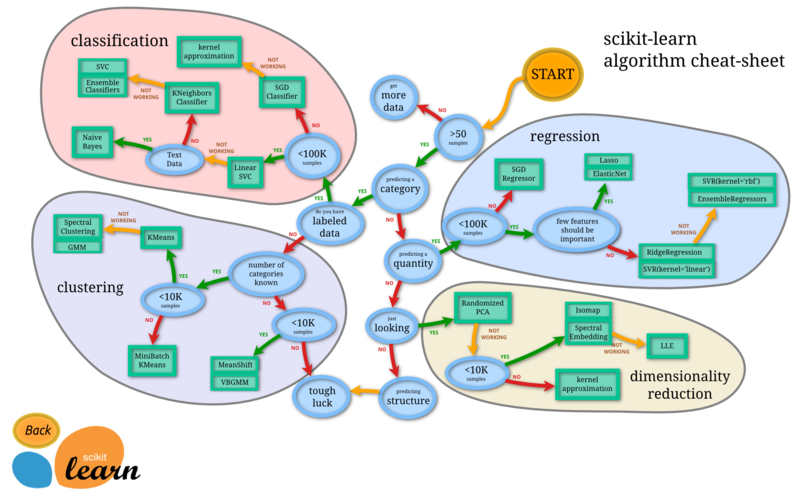



### 5.1 Regresión Lineal Simple

Vamos a probar lo más sencillo, que es utilizar una regresión lineal con la variable explicativa que más correlación presenta (Antigüedad):

Error cuadrático medio (MSE): 0.0213
Coeficiente de determinación (R2): 0.6777


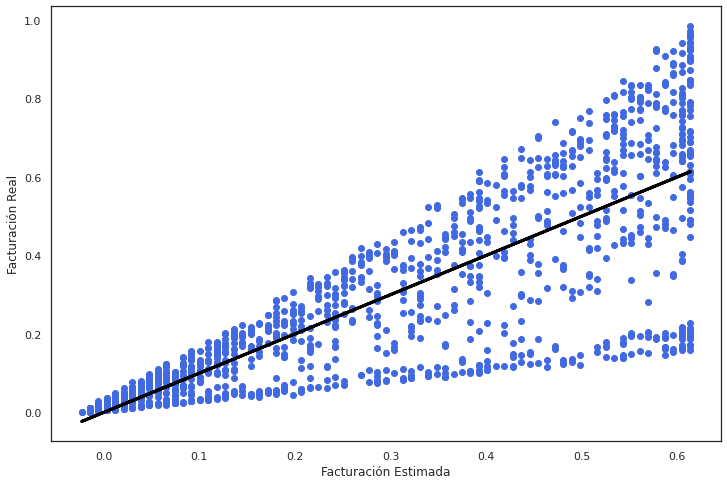

In [ ]:
from sklearn import linear_model
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.model_selection import train_test_split

x_cols = ['Antigüedad']
y_cols = ['TotalFacturado']

# Normalizamos las dos variables, para poder interpretar mejor los resultados
scaler = MinMaxScaler()
X = scaler.fit_transform(df2[x_cols])
y = scaler.fit_transform(df2[y_cols])

# Generamos el dataset de entrenamiento y el de test
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20, random_state=47)

# Entrenamos el modelo
lg = linear_model.LinearRegression()
lg.fit(X_train, y_train)

# Evaluamos el modelo
y_pred = lg.predict(X_test)

print(f"Error cuadrático medio (MSE): {mean_squared_error(y_test, y_pred):.4f}")
print(f"Coeficiente de determinación (R2): {r2_score(y_test, y_pred):.4f}")

fig, ax = plt.subplots(figsize=(12,8))
plt.scatter(y_pred, y_test,  color='royalblue')
plt.plot(y_pred, y_pred, color='black', linewidth=3)

plt.xlabel('Facturación Estimada')
plt.ylabel('Facturación Real')
plt.show()

Los resultados no son muy espectaculares, pero al menos son lo suficientemente representativos como para ser considerados aceptables.

Veamos si podemos mejorarlo añadiendo más variables a la regresión:

### 5.2 Regresión Lineal Múltiple

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:31: UserWarning: In Matplotlib 3.3 individual lines on a stem plot will be added as a LineCollection instead of individual lines. This significantly improves the performance of a stem plot. To remove this warning and switch to the new behaviour, set the "use_line_collection" keyword argument to True.


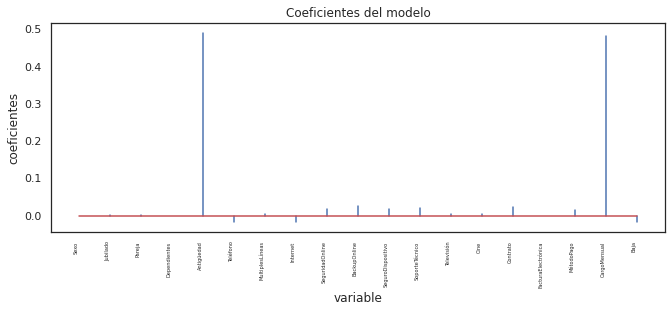

In [ ]:
# Cogemos todas las variables explicativas
X = df2.drop(columns='TotalFacturado')
y = df2['TotalFacturado']

# Normalizamos las variables para interpretar mejor el resultado
scaler = MinMaxScaler()
scaled_features = scaler.fit_transform(X.values)
X = pd.DataFrame(scaled_features, index=X.index, columns=X.columns)
y = scaler.fit_transform(df2[['TotalFacturado']])


X_train, X_test, y_train, y_test = train_test_split(
                                        X,
                                        y,
                                        train_size   = 0.7,
                                        random_state = 1234,
                                        shuffle      = True
                                    )

# Creación y entrenamiento del modelo
modelo = linear_model.LinearRegression()
modelo.fit(X = X_train, y = y_train)

# Coeficientes del modelo
df_coeficientes = pd.DataFrame(
                        {'predictor': X_train.columns,
                         'coef': modelo.coef_.flatten()}
                  )

fig, ax = plt.subplots(figsize=(11, 3.84))
ax.stem(df_coeficientes.predictor, df_coeficientes.coef, markerfmt=' ')
plt.xticks(rotation=90, ha='right', size=5)
ax.set_xlabel('variable')
ax.set_ylabel('coeficientes')
ax.set_title('Coeficientes del modelo');

Como se puede observar CargoMensual también está fuertemente correlada y el resto podríamos despreciar su contribución y eliminarlas. No obstante, vamos a ver si es suficiente para mejorar el anterior modelo:


Error cuadrático medio (MSE): 0.0061
Raíz del Error cuadrático medio (MSE): 0.0783
Coeficiente de determinación (R2): 0.9105


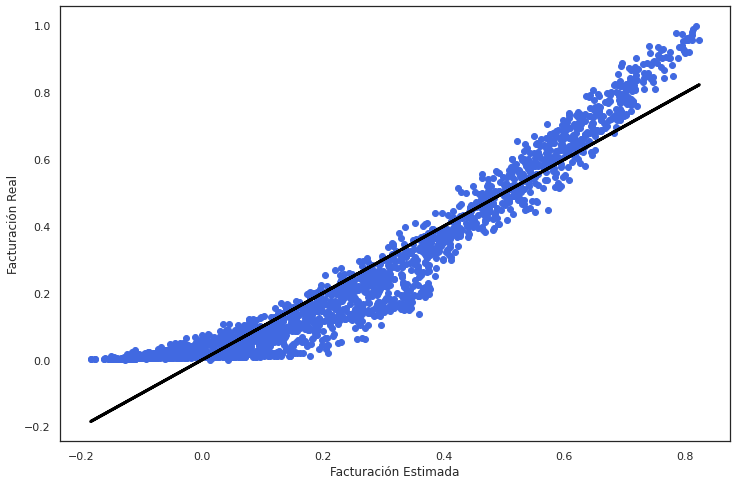

In [ ]:
# Evaluamos el modelo
y_pred = modelo.predict(X=X_test)
y_pred = y_pred.flatten()
y_pred[:10]

print("")
print(f"Error cuadrático medio (MSE): {mean_squared_error(y_test, y_pred):.4f}")
print(f"Raíz del Error cuadrático medio (MSE): {mean_squared_error(y_test, y_pred,squared=False):.4f}")
print(f"Coeficiente de determinación (R2): {r2_score(y_test, y_pred):.4f}")

fig, ax = plt.subplots(figsize=(12,8))
plt.scatter(y_pred, y_test,  color='royalblue')
plt.plot(y_pred, y_pred, color='black', linewidth=3)

plt.xlabel('Facturación Estimada')
plt.ylabel('Facturación Real')
plt.show()

Ahora observamos que los resultados son mucho mejores: con un coeficiente de determinación tan cercano a 1 se considera una muy buena estimación.
A continuación, vamos a utilizar las regularizaciones Ridge y Lasso para ver si se comporta mejor:

### 5.3 Regularización Ridge

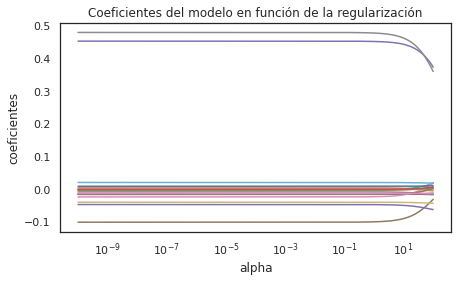

In [ ]:
# Creación y entrenamiento del modelo (con búsqueda por CV del valor óptimo alpha)
# Por defecto RidgeCV utiliza el mean squared error
modelo = linear_model.RidgeCV(
            alphas          = np.logspace(-10, 2, 200),
            fit_intercept   = True,
            store_cv_values = True
         )

_ = modelo.fit(X = X_train, y = y_train)


# Evolución de los coeficientes en función de alpha
alphas = modelo.alphas
coefs = []

for alpha in alphas:
    modelo_temp = linear_model.Ridge(alpha=alpha, fit_intercept=False)
    modelo_temp.fit(X_train, y_train)
    coefs.append(modelo_temp.coef_.flatten())

fig, ax = plt.subplots(figsize=(7, 3.84))
ax.plot(alphas, coefs)
ax.set_xscale('log')
ax.set_xlabel('alpha')
ax.set_ylabel('coeficientes')
ax.set_title('Coeficientes del modelo en función de la regularización');
plt.axis('tight')
plt.show()

Como se puede observar **apenas tiene efecto la regularización** sobre los coeficientes de la regresión lineal, con lo que **deberíamos descartar su utilización**.

A modo ilustrativo, se incluyen los pasos a seguir en caso de que sí fuera relevante

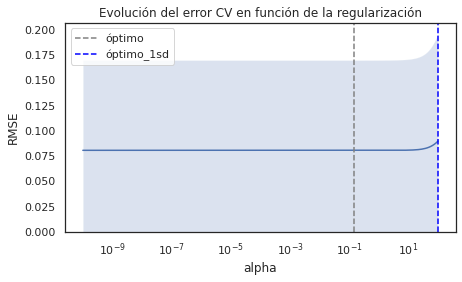

In [ ]:
# Evolución del error en función de alpha

# modelo.cv_values almacena el mse de cv para cada valor de alpha. Tiene dimensiones (n_samples, n_targets, n_alphas)
mse_cv = modelo.cv_values_.reshape((-1, 200)).mean(axis=0)
mse_sd = modelo.cv_values_.reshape((-1, 200)).std(axis=0)

# Se aplica la raíz cuadrada para pasar de mse a rmse
rmse_cv = np.sqrt(mse_cv)
rmse_sd = np.sqrt(mse_sd)

# Se identifica el óptimo y el óptimo + 1std
min_rmse     = np.min(rmse_cv)
sd_min_rmse  = rmse_sd[np.argmin(rmse_cv)]
min_rsme_1sd = np.max(rmse_cv[rmse_cv <= min_rmse + sd_min_rmse])
optimo       = modelo.alphas[np.argmin(rmse_cv)]
optimo_1sd   = modelo.alphas[rmse_cv == min_rsme_1sd]


# Gráfico del error +- 1 desviación estándar
fig, ax = plt.subplots(figsize=(7, 3.84))
ax.plot(modelo.alphas, rmse_cv)
ax.fill_between(
    modelo.alphas,
    rmse_cv + rmse_sd,
    rmse_cv - rmse_sd,
    alpha=0.2
)

ax.axvline(
    x         = optimo,
    c         = "gray",
    linestyle = '--',
    label     = 'óptimo'
)

ax.axvline(
    x         = optimo_1sd,
    c         = "blue",
    linestyle = '--',
    label     = 'óptimo_1sd'
)
ax.set_xscale('log')
ax.set_ylim([0,None])
ax.set_title('Evolución del error CV en función de la regularización')
ax.set_xlabel('alpha')
ax.set_ylabel('RMSE')
plt.legend();

In [ ]:

# Mejor valor alpha encontrado
print(f"Mejor valor de alpha encontrado: {modelo.alpha_}")



Mejor valor de alpha encontrado: 0.14649713983072818


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: UserWarning: In Matplotlib 3.3 individual lines on a stem plot will be added as a LineCollection instead of individual lines. This significantly improves the performance of a stem plot. To remove this warning and switch to the new behaviour, set the "use_line_collection" keyword argument to True.
  


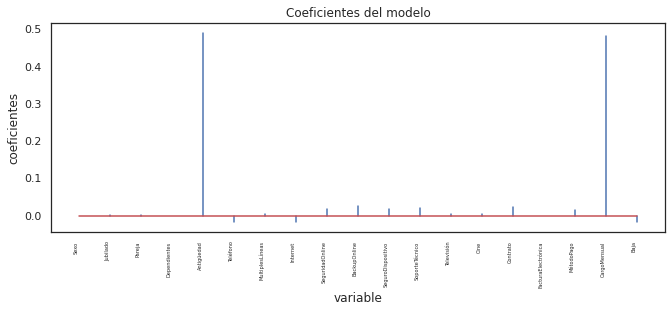

In [ ]:
# Coeficientes del modelo
df_coeficientes = pd.DataFrame(
                        {'predictor': X_train.columns,
                         'coef': modelo.coef_.flatten()}
                  )

fig, ax = plt.subplots(figsize=(11, 3.84))
ax.stem(df_coeficientes.predictor, df_coeficientes.coef, markerfmt=' ')
plt.xticks(rotation=90, ha='right', size=5)
ax.set_xlabel('variable')
ax.set_ylabel('coeficientes')
ax.set_title('Coeficientes del modelo');

Evaluaríamos la mejor del modelo:

In [ ]:
# Predicciones test
y_pred = modelo.predict(X=X_test)
y_pred = y_pred.flatten()
y_pred[:10]

print("")
print(f"Error cuadrático medio (MSE): {mean_squared_error(y_test, y_pred):.4f}")
print(f"Raíz del Error cuadrático medio (MSE): {mean_squared_error(y_test, y_pred,squared=False):.4f}")
print(f"Coeficiente de determinación (R2): {r2_score(y_test, y_pred):.4f}")


Error cuadrático medio (MSE): 0.0061
Raíz del Error cuadrático medio (MSE): 0.0783
Coeficiente de determinación (R2): 0.9105


### 5.4 Regularización Lasso

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_coordinate_descent.py:1571: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


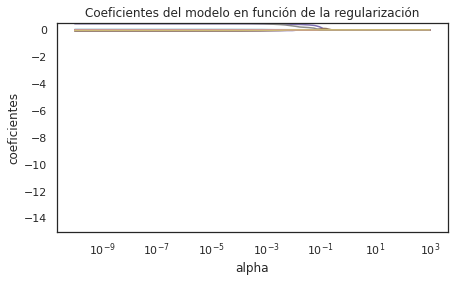

In [ ]:
# Creación y entrenamiento del modelo (con búsqueda por CV del valor óptimo alpha)
# Por defecto LassoCV utiliza el mean squared error
modelo = linear_model.LassoCV(
            alphas          = np.logspace(-10, 3, 200),
            cv              = 10
         )
_ = modelo.fit(X = X_train, y = y_train)

# Evolución de los coeficientes en función de alpha
alphas = modelo.alphas_
coefs = []

for alpha in alphas:
    modelo_temp = linear_model.Lasso(alpha=alpha, fit_intercept=False)
    modelo_temp.fit(X_train, y_train)
    coefs.append(modelo_temp.coef_.flatten())

fig, ax = plt.subplots(figsize=(7, 3.84))
ax.plot(alphas, coefs)
ax.set_xscale('log')
ax.set_ylim([-15,None])
ax.set_xlabel('alpha')
ax.set_ylabel('coeficientes')
ax.set_title('Coeficientes del modelo en función de la regularización');

Como cabía esperar, no vamos a conseguir ningún tipo de mejora y la descartaríamos. De manera análoga a la anterior, vamos a exponer los pasos que se deberían seguir para ejecutarla ya que va a ilustrarnos como deberíamos a ver reducido la dimensionalidad del *dataset*.

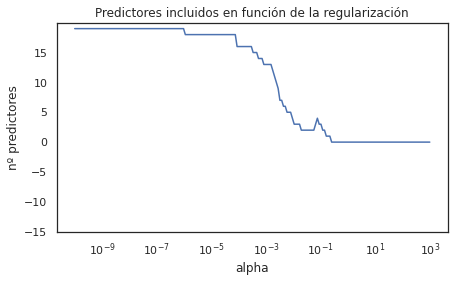

In [ ]:
# Número de predictores incluidos (coeficiente !=0) en función de alpha
alphas = modelo.alphas_
n_predictores = []

for alpha in alphas:
    modelo_temp = linear_model.Lasso(alpha=alpha, fit_intercept=False)
    modelo_temp.fit(X_train, y_train)
    coef_no_cero = np.sum(modelo_temp.coef_.flatten() != 0)
    n_predictores.append(coef_no_cero)

fig, ax = plt.subplots(figsize=(7, 3.84))
ax.plot(alphas, n_predictores)
ax.set_xscale('log')
ax.set_ylim([-15,None])
ax.set_xlabel('alpha')
ax.set_ylabel('nº predictores')
ax.set_title('Predictores incluidos en función de la regularización');

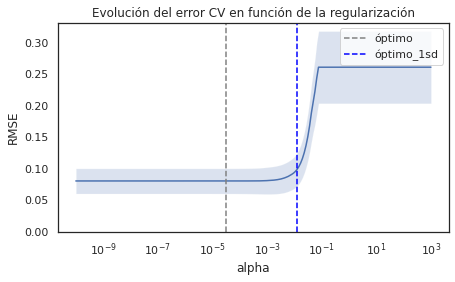

In [ ]:
# Evolución del error en función de alpha
# ==============================================================================
# modelo.mse_path_ almacena el mse de cv para cada valor de alpha. Tiene
# dimensiones (n_alphas, n_folds)
mse_cv = modelo.mse_path_.mean(axis=1)
mse_sd = modelo.mse_path_.std(axis=1)

# Se aplica la raíz cuadrada para pasar de mse a rmse
rmse_cv = np.sqrt(mse_cv)
rmse_sd = np.sqrt(mse_sd)

# Se identifica el óptimo y el óptimo + 1std
min_rmse     = np.min(rmse_cv)
sd_min_rmse  = rmse_sd[np.argmin(rmse_cv)]
min_rsme_1sd = np.max(rmse_cv[rmse_cv <= min_rmse + sd_min_rmse])
optimo       = modelo.alphas_[np.argmin(rmse_cv)]
optimo_1sd   = modelo.alphas_[rmse_cv == min_rsme_1sd]

# Gráfico del error +- 1 desviación estándar
fig, ax = plt.subplots(figsize=(7, 3.84))
ax.plot(modelo.alphas_, rmse_cv)
ax.fill_between(
    modelo.alphas_,
    rmse_cv + rmse_sd,
    rmse_cv - rmse_sd,
    alpha=0.2
)

ax.axvline(
    x         = optimo,
    c         = "gray",
    linestyle = '--',
    label     = 'óptimo'
)

ax.axvline(
    x         = optimo_1sd,
    c         = "blue",
    linestyle = '--',
    label     = 'óptimo_1sd'
)

ax.set_xscale('log')
ax.set_ylim([0,None])
ax.set_title('Evolución del error CV en función de la regularización')
ax.set_xlabel('alpha')
ax.set_ylabel('RMSE')
plt.legend();

In [ ]:
# Mejor valor alpha encontrado
print(f"Mejor valor de alpha encontrado: {modelo.alpha_}")

Mejor valor de alpha encontrado: 3.072112998861759e-05


In [ ]:
# Mejor valor alpha encontrado + 1sd
min_rmse     = np.min(rmse_cv)
sd_min_rmse  = rmse_sd[np.argmin(rmse_cv)]
min_rsme_1sd = np.max(rmse_cv[rmse_cv <= min_rmse + sd_min_rmse])
optimo       = modelo.alphas_[np.argmin(rmse_cv)]
optimo_1sd   = modelo.alphas_[rmse_cv == min_rsme_1sd]

print(f"Mejor valor de alpha encontrado + 1 desviación estándar: {optimo_1sd}")

Mejor valor de alpha encontrado + 1 desviación estándar: [0.01260383]


In [ ]:
# Mejor modelo alpha óptimo + 1sd
modelo = linear_model.Lasso(alpha=optimo_1sd)
modelo.fit(X_train, y_train)

Lasso(alpha=array([0.01260383]))

In [ ]:
# Coeficientes del modelo
df_coeficientes = pd.DataFrame(
                        {'predictor': X_train.columns,
                         'coef': modelo.coef_.flatten()}
                  )

# Predictores incluidos en el modelo (coeficiente != 0)
df_coeficientes[df_coeficientes.coef != 0]

,predictor,coef
4,Antigüedad,0.46
17,CargoMensual,0.30


El resultado es el esperado: sólo se incluyen las dos variables cuantitativas que más correlación tenía.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: UserWarning: In Matplotlib 3.3 individual lines on a stem plot will be added as a LineCollection instead of individual lines. This significantly improves the performance of a stem plot. To remove this warning and switch to the new behaviour, set the "use_line_collection" keyword argument to True.
  after removing the cwd from sys.path.


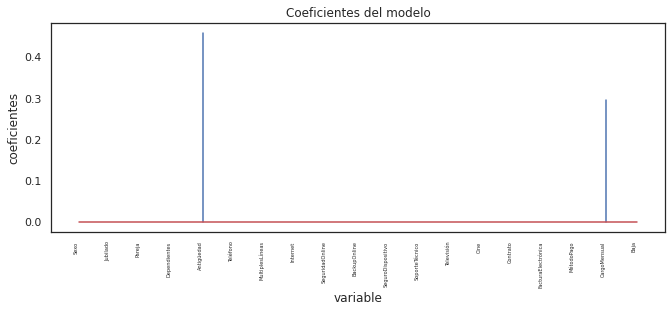

In [ ]:
fig, ax = plt.subplots(figsize=(11, 3.84))
ax.stem(df_coeficientes.predictor, df_coeficientes.coef, markerfmt=' ')
plt.xticks(rotation=90, ha='right', size=5)
ax.set_xlabel('variable')
ax.set_ylabel('coeficientes')
ax.set_title('Coeficientes del modelo');

In [ ]:
# Predicciones test
y_test = modelo.predict(X=X_test)
y_test = y_test.flatten()
y_test[:10]

# Error de test del modelo
rmse_lasso = mean_squared_error(
                y_true  = y_test,
                y_pred  = predicciones,
                squared = False
             )
print("")
print(f"Error cuadrático medio (MSE): {mean_squared_error(y_test, y_pred):.4f}")
print(f"Raíz del Error cuadrático medio (MSE): {mean_squared_error(y_test, y_pred,squared=False):.4f}")
print(f"Coeficiente de determinación (R2): {r2_score(y_test, y_pred):.4f}")


Error cuadrático medio (MSE): 0.0035
Raíz del Error cuadrático medio (MSE): 0.0589
Coeficiente de determinación (R2): 0.9120


Hemos conseguido mejorar un poco el MSE, vamos a visualizar para ver este efecto:

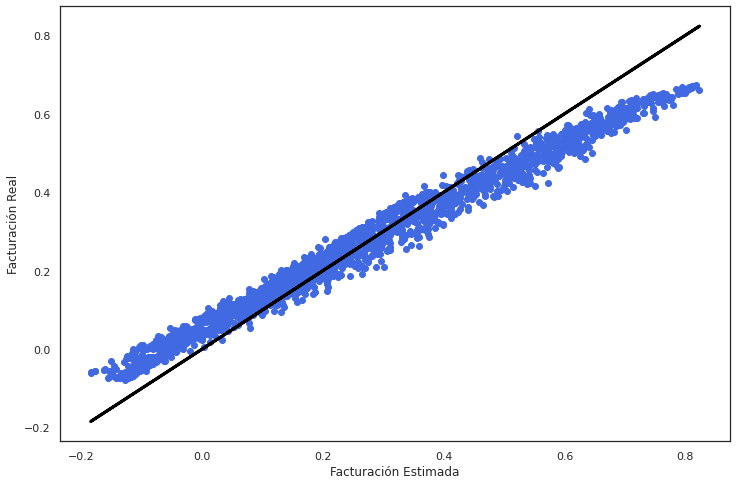

In [ ]:

fig, ax = plt.subplots(figsize=(12,8))
plt.scatter(y_pred, y_test,  color='royalblue')
plt.plot(y_pred, y_pred, color='black', linewidth=3)

plt.xlabel('Facturación Estimada')
plt.ylabel('Facturación Real')
plt.show()

Como se puede observar, el efecto de la regularización Lasso, nos ha "concentrado" los puntos, minimizando el MSE.

## Despliegue

Se propone una narrativa de datos sencilla para el presente proyecto a modo de plantilla ilustrativa en el fichero "Ejemplo_Solucion_Historia_CasoUD3.pptx"